# 1. Récupération des 160000 tweets postés par les clients

In [32]:
import warnings
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow import keras


warnings.filterwarnings('ignore')

missing_values = ["na", "n/a", "--", " "]
data_df = pd.read_csv('tweet_160000.csv',
                      encoding='latin',
                      delimiter=",")


data_df.tail()

,sentiment,id,date,query,user,tweet
159995,1,1689009522,Sun May 03 12:25:02 PDT 2009,NO_QUERY,stephstar20,@mariaruizx lucky.. that is soo great! I wish ...
159996,1,1977823875,Sat May 30 21:47:31 PDT 2009,NO_QUERY,KGWSunrise,BB: I think Directors Paul and Scooter r keepi...
159997,1,1966616026,Fri May 29 18:05:24 PDT 2009,NO_QUERY,tmj4340,Power's back. I really didn't cut the power li...
159998,1,2003659622,Tue Jun 02 06:55:50 PDT 2009,NO_QUERY,jcimagination,Great website for Icon Search...http://www.ico...
159999,1,1974676545,Sat May 30 13:37:10 PDT 2009,NO_QUERY,yvonny123,and i want DIVERSITY too WINN!


# 2. Pré-traitement des tweets

In [33]:
import re
import os
import spacy
import string
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences


tweets = []

tweets = data_df['tweet'].tolist()

REPLACE_NO_SPACE = re.compile("[.;:!\?,\"()\[\]]")
REPLACE_WITH_SPACE = re.compile("(<br\s*/><br\s*/>)|(\-)|(\/)|(\n)|(')|[0-9]")

def preprocess_reviews(reviews):
    reviews = [REPLACE_NO_SPACE.sub("", line.lower()) for line in reviews]
    reviews = [REPLACE_WITH_SPACE.sub(" ", line) for line in reviews]
    
    return reviews

tweets = preprocess_reviews(tweets)

sp = string.punctuation
tweets = list(map(lambda t: ''.join(["" if c.isdigit() else c for c in t]), tweets))
tweets = list(map(lambda t: ''.join(["" if c in sp else c for c in t]), tweets))
tweets = list(map(str.lower, tweets))

nlp = spacy.load('en_core_web_sm')
def get_lemmatized_text(corpus):
    lem = [' '.join([token.lemma_ for token in nlp(review)]) for review in corpus]
    return lem
    
tweets = get_lemmatized_text(tweets)

stop_words_ot = ['a', 'about', 'above', 'the', 'after', 'my', 'me', 'our',
                 'your', 'i', 'we', 'you', 'he', 'she', 'they',
                 'their', 'in', 'until', 'before', 'it', 'and', 'at', 'of']


def remove_stop_words(corpus, stop_words):
    removed_stop_words = []
    for review in corpus:
        removed_stop_words.append(
            ' '.join([word for word in review.split() 
                      if word not in stop_words])
            )
    return removed_stop_words

tweets = remove_stop_words(tweets, stop_words_ot)   

data_df['clean_tweet'] = tweets

tokenizer = Tokenizer(nb_words=2500, lower=True, split=' ')
tokenizer.fit_on_texts(data_df['clean_tweet'].values)
vocab_length = len(tokenizer.word_index) + 1
print("Tokenizer vocab length:", vocab_length)

X = tokenizer.texts_to_sequences(data_df['clean_tweet'].values)
X = pad_sequences(X)

Tokenizer vocab length: 135935


* Tweets après le pré-traitement :

In [34]:
data_df.tail()

,sentiment,id,date,query,user,tweet,clean_tweet
159995,1,1689009522,Sun May 03 12:25:02 PDT 2009,NO_QUERY,stephstar20,@mariaruizx lucky.. that is soo great! I wish ...,mariaruizx lucky that be soo great wish could ...
159996,1,1977823875,Sat May 30 21:47:31 PDT 2009,NO_QUERY,KGWSunrise,BB: I think Directors Paul and Scooter r keepi...,bb think director paul scooter r keep thing fr...
159997,1,1966616026,Fri May 29 18:05:24 PDT 2009,NO_QUERY,tmj4340,Power's back. I really didn't cut the power li...,power s back really didn t cut power line with...
159998,1,2003659622,Tue Jun 02 06:55:50 PDT 2009,NO_QUERY,jcimagination,Great website for Icon Search...http://www.ico...,great website for icon searchhttp wwwiconfinde...
159999,1,1974676545,Sat May 30 13:37:10 PDT 2009,NO_QUERY,yvonny123,and i want DIVERSITY too WINN!,want diversity too winn


# 3. Création du réseau RNN avec cellule **LSTM**

In [35]:

embed_dim = 128
lstm_out = 200
batch_size = 32

model = tf.keras.models.Sequential()

# Add an Embedding layer expecting input vocab of size 2500, and
# output embedding dimension of size 128.
model.add(tf.keras.layers.Embedding(2500, embed_dim, input_length = X.shape[1]))

# Add a LSTM layer with 200 internal units
model.add(tf.keras.layers.LSTM(lstm_out))

# Add a Dense layer with 2 units
model.add(tf.keras.layers.Dense(2,activation='sigmoid'))

model.compile(loss='sparse_categorical_crossentropy', optimizer='adam',
              metrics=['accuracy'])

print(model.summary())

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_4 (Embedding)      (None, 34, 128)           320000    
_________________________________________________________________
lstm_6 (LSTM)                (None, 200)               263200    
_________________________________________________________________
dense_6 (Dense)              (None, 2)                 402       
Total params: 583,602
Trainable params: 583,602
Non-trainable params: 0
_________________________________________________________________
None


* Apprentissage du modèle RNN sur le jeu d'entrainement :

In [36]:
from sklearn.model_selection import train_test_split

Y = data_df['sentiment'].values
X_train, X_valid, Y_train, Y_valid = train_test_split(X, Y,
                                                      test_size=0.05,
                                                      random_state=36)

model.fit(X_train, Y_train, epochs=10)

Train on 152000 samples
Epoch 1/10
152000/152000 [==============================] - 276s 2ms/sample - loss: 0.4834 - acc: 0.7673
Epoch 2/10
152000/152000 [==============================] - 271s 2ms/sample - loss: 0.4395 - acc: 0.7923
Epoch 3/10
152000/152000 [==============================] - 259s 2ms/sample - loss: 0.4196 - acc: 0.8035
Epoch 4/10
152000/152000 [==============================] - 257s 2ms/sample - loss: 0.4012 - acc: 0.8134
Epoch 5/10
152000/152000 [==============================] - 265s 2ms/sample - loss: 0.3801 - acc: 0.8247
Epoch 6/10
152000/152000 [==============

* Performance du modèle :

In [37]:
score, acc = model.evaluate(X_valid, Y_valid, batch_size=batch_size, verbose=2)
print('Score : %.2f' % (score))
print('Validation accuracy : %.2f' % (acc))


8000/8000 - 2s - loss: 0.7112 - acc: 0.7744
Score : 0.71
Validation accuracy : 0.77


# 4. Word Embeddings avec Word2Vec

> Il s'agit d' un réseau de neurones à 2 couches prenant en entrée un corpus et le transformant en vecteur dense numérique pour chaque mot.
Il permet de prédire le contexte d' un mot, les similarités synthaxiques et sémantiques avec d'autres mots du corpus.
Word2Vec a été développé par Google et repose sur 2 méthodes telles que **Skip Gram** et **CBOW (Continuous Bag Of Words)**.


In [38]:
import gensim
Embedding_dimensions = 100

# Transformation de la colonne text_review en liste de listes
def read_review(row, column_name):
    return gensim.utils.simple_preprocess(str(row[column_name])\
                                          .encode('utf-8'))
    
documents = []

for index, row in data_df.iterrows():
    documents.append(read_review(row,"clean_tweet"))
    
# Création du modèle Word2Vec    
model = gensim.models.Word2Vec(size=Embedding_dimensions, window=5,
                               min_count=1, sg=0, workers=4)
model.build_vocab(documents)

# Entrainement du modèle Word2Vec
model.train(sentences=documents,
            total_examples=len(documents),
            epochs=model.iter)

(7039849, 9108360)

In [39]:
print("Vocabulary Length:", len(model.wv.vocab))

Vocabulary Length: 132563


* Récupération du vocabulaire appris :

In [40]:
word_vectors = model.wv

count = 0
for word in word_vectors.vocab:
    if count < 20:
        print(word)
        count += 1
    else:
        break

yup
always
let
down
reganmett
ahh
miss
pron
auwshhh
back
hurt
really
bad
from
left
shoulder
bone
all
way
to


* Création de la matrice de plongement **Embedding Matrix**:

> Elle contient l'ensemble des mots utilisés dans les tweets et leur vecteur dense associé

In [41]:
embedding_matrix = np.zeros((vocab_length, Embedding_dimensions))

for word, token in tokenizer.word_index.items():
    if model.wv.__contains__(word):
        embedding_matrix[token] = model.wv.__getitem__(word)

print("Embedding Matrix Shape:", embedding_matrix.shape)

Embedding Matrix Shape: (135935, 100)


# 5. Word Embeddings avec GloVe

GloVe (Global Vectors for Word Representation) est un algorithme d'apprentissage non supervisé permettant d'obtenir
une représentation vectorielle des mots d'un texte. Il est basé sur la co-occurence et rapproche des mots d'un texte ayant la même
représentation vectorielle dans l'espace vectoriel de représenation (après plongement).


In [12]:
embeddings_dictionary = dict()

# Load GloVe 100D embeddings
with open('glove.6B.100d.txt') as fp:
    for line in fp.readlines():
        records = line.split()
        word = records[0]
        vector_dimensions = np.asarray(records[1:], dtype='float32')
        embeddings_dictionary [word] = vector_dimensions


# Now we will load embedding vectors of those words that appear in the
# Glove dictionary. Others will be initialized to 0.

embedding_matrix_glove = np.zeros((vocab_length, Embedding_dimensions))

for word, index in tokenizer.word_index.items():
    embedding_vector = embeddings_dictionary.get(word)
    if embedding_vector is not None:
        embedding_matrix_glove[index] = embedding_vector
        
embedding_matrix_glove

['the', '-0.038194', '-0.24487', '0.72812', '-0.39961', '0.083172', '0.043953', '-0.39141', '0.3344', '-0.57545', '0.087459', '0.28787', '-0.06731', '0.30906', '-0.26384', '-0.13231', '-0.20757', '0.33395', '-0.33848', '-0.31743', '-0.48336', '0.1464', '-0.37304', '0.34577', '0.052041', '0.44946', '-0.46971', '0.02628', '-0.54155', '-0.15518', '-0.14107', '-0.039722', '0.28277', '0.14393', '0.23464', '-0.31021', '0.086173', '0.20397', '0.52624', '0.17164', '-0.082378', '-0.71787', '-0.41531', '0.20335', '-0.12763', '0.41367', '0.55187', '0.57908', '-0.33477', '-0.36559', '-0.54857', '-0.062892', '0.26584', '0.30205', '0.99775', '-0.80481', '-3.0243', '0.01254', '-0.36942', '2.2167', '0.72201', '-0.24978', '0.92136', '0.034514', '0.46745', '1.1079', '-0.19358', '-0.074575', '0.23353', '-0.052062', '-0.22044', '0.057162', '-0.15806', '-0.30798', '-0.41625', '0.37972', '0.15006', '-0.53212', '-0.2055', '-1.2526', '0.071624', '0.70565', '0.49744', '-0.42063', '0.26148', '-1.538', '-0.30223

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub data rate 

# 6. Création d'un modèle RNN avec LSTM bidimensionnel

## Architecture du modèle :

1) Embedding Layer: Layer responsable de la conversion des tokens en représentation vectorielle généré par Word2Vec

Arguments -

input_dim: Taille du vocabulaire.
output_dim: Dimension du vecteur dense.
weights: Initialise la matrice de plongement.
trainable: Specifie la couche doit être entrainée ou pas.

2) Bidirectional: Traitement bidirectional du texte. Cela signifie que le contexte des tweets est traité de gauche à droite et de droite à gauche.

3) LSTM: Long Short Term Memory, C'est un variant du RNN contenant une cellule à mémoire internew pour apprendre le contexte à long terme des mots plutôt que les mots voisins
   effectué par le RNN classique.

Arguments -


units: entier positif, dimension de l'espace en sortie.
dropout: Fraction of the units to drop for the linear transformation of the inputs.
return_sequence: Whether to return the last output in the output sequence, or the full sequence.

4) Conv1D: couche convolutionnel 1D

Arguments -

filters: The dimensionality of the output space (i.e. the number of output filters in the convolution).
kernel_size: Specifies the length of the 1D convolution window.
activation: Specifies the activation function to use.

5) GlobalMaxPool1D: Réduction de la dimension en entrée en prenant le maximum pour chaque Dimension

6) Dense : couhe dense.

Fonction d' activation "Sigmoid", qui transforme l'entrée en un nombre compris entre 0 and 1.



In [47]:
def getModel():
    embedding_layer = keras.layers.Embedding(input_dim = vocab_length, 
                                output_dim = Embedding_dimensions,
                                weights=[embedding_matrix], 
                                input_length=X.shape[1],
                                trainable=False)

    model = tf.keras.models.Sequential([
        embedding_layer,
        keras.layers.Bidirectional(keras.layers.LSTM(100, dropout=0.3, return_sequences=True)),
        keras.layers.Bidirectional(keras.layers.LSTM(100, dropout=0.3, return_sequences=True)),
        keras.layers.Conv1D(100, 5, activation='relu'),
        keras.layers.GlobalMaxPool1D(),
        keras.layers.Dense(16, activation='relu'),
        keras.layers.Dense(2, activation='sigmoid'),
    ])
    return model

* Résumé du modèle :

In [48]:
training_model = getModel()
training_model.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_6 (Embedding)      (None, 34, 100)           13593500  
_________________________________________________________________
bidirectional_6 (Bidirection (None, 34, 200)           160800    
_________________________________________________________________
bidirectional_7 (Bidirection (None, 34, 200)           240800    
_________________________________________________________________
conv1d_3 (Conv1D)            (None, 30, 100)           100100    
_________________________________________________________________
global_max_pooling1d_3 (Glob (None, 100)               0         
_________________________________________________________________
dense_9 (Dense)              (None, 16)                1616      
_________________________________________________________________
dense_10 (Dense)             (None, 2)                

* Apprentissage du modèle séquentiel sur le jeu d'entrainement :

Utilisation du Callbacks

ReduceLROnPlateau: Reduction du taux d'apprentissage si le gain de performance ne s'améliore pas

monitor: quantité à monitorer.
patience: number de epochs sans amélioration après lequel le taux d'apprentissage sera réduit.
cooldown: number de epochs en attente.

EarlyStopping: Stop l'entrainement quand la métrique monitoré a arreté son amélioration.

monitor: quantité à monitorer.
min_delta: changement minimal de la quantité à monitorer qu'on peut qualifier comme amélioration.
patience: number de epochs sans amélioration après lequel le taux d'apprentissage sera réduit.



In [49]:
callbacks = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',
             patience=5, 
             cooldown=0),
             tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                           min_delta=1e-4,
                           patience=5)]


training_model.compile(loss='sparse_categorical_crossentropy',
                       optimizer='adam',
                       metrics=['accuracy'])

Arguments:

batch_size: Nombre de records par mise à jour du gradient. L' augmentation du batch_size va augmenter la vitesse d'entrainement.

epochs: Nombre de epochs pour entrainer le modèle. Un epoch est une itération sur les données x et y.

validation_split: Nombre décimal entre 0 et 1. Fraction des données d'entrainement utilisée pour la validation.

callbacks: List des callbacks à appliquer durant le processus d'entrainement.

verbose: 0, 1, or 2. Verbosity mode. 0 = silent, 1 = progress bar, 2 = one line per epoch.

In [50]:
history = training_model.fit(X_train, Y_train,
                             batch_size=1024,
                             epochs=12,
                             validation_split=0.1,
                             callbacks=callbacks,
                             verbose=1,
)

Train on 136800 samples, validate on 15200 samples
Epoch 1/12
136800/136800 [==============================] - 135s 985us/sample - loss: 0.6032 - acc: 0.6631 - val_loss: 0.5587 - val_acc: 0.7117
Epoch 2/12
136800/136800 [==============================] - 154s 1ms/sample - loss: 0.5375 - acc: 0.7246 - val_loss: 0.5163 - val_acc: 0.7457
Epoch 3/12
136800/136800 [==============================] - 173s 1ms/sample - loss: 0.5171 - acc: 0.7410 - val_loss: 0.4994 - val_acc: 0.7556
Epoch 4/12
136800/136800 [==============================] - 163s 1ms/sample - loss: 0.5062 - acc: 0.7489 - val_loss: 0.4892 - val_acc: 0.7615
Epoch 5/12
136800/136800 [==============================] - 136s 991us/sample - loss: 0.4960 - acc: 0.7559 - val_loss: 0.4881 - val_acc: 0.7647
Epoch 6/12
136800/136800 [==============================] - 138s 1ms/sample - loss: 0.4893 - acc: 0.7602 - val_loss: 0.4846 - val_acc: 0.7621
Epoch 7/12
136800/136800 [==============================] - 135s 987us/sample - loss: 0.4834 

* Sauvegarde du modèle dans Azure ML:

In [51]:
filepath = './saved_model'
tf.keras.models.save_model(training_model, filepath)

* Définition de l'environnement et inscription dans l'espace de travail:

In [52]:
from azureml.core.environment import Environment
from azureml.core.conda_dependencies import CondaDependencies
from azureml.core import Workspace

ws = Workspace.from_config()
print(ws.name, ws.resource_group, ws.location, ws.subscription_id, sep='\n')

env = Environment('env-sentiment')
cd = CondaDependencies.create(pip_packages=['azureml-dataset-runtime[pandas,fuse]', 'azureml-defaults'],
                                            conda_packages=['scikit-learn==0.22.1',
                                            'numpy==1.18.5', 'gensim==3.8.3', 'joblib==0.14.1'])

env.python.conda_dependencies = cd

env.register(workspace=ws)

myworkspace
myresourcegroup
westeurope
eb572890-26d8-4841-b702-9e75c9697573


{
    "databricks": {
        "eggLibraries": [],
        "jarLibraries": [],
        "mavenLibraries": [],
        "pypiLibraries": [],
        "rcranLibraries": []
    },
    "docker": {
        "arguments": [],
        "baseDockerfile": null,
        "baseImage": "mcr.microsoft.com/azureml/openmpi3.1.2-ubuntu18.04:20210531.v1",
        "baseImageRegistry": {
            "address": null,
            "password": null,
            "registryIdentity": null,
            "username": null
        },
        "enabled": false,
        "platform": {
            "architecture": "amd64",
            "os": "Linux"
        },
        "sharedVolumes": true,
        "shmSize": null
    },
    "environmentVariables": {
        "EXAMPLE_ENV_VAR": "EXAMPLE_VALUE"
    },
    "inferencingStackVersion": null,
    "name": "env-sentiment",
    "python": {
        "baseCondaEnvironment": null,
        "condaDependencies": {
            "channels": [
                "anaconda",
                "conda-forge"


* Enregistrement du modèle dans Azure ML:

In [54]:
from azureml.core.model import Model
import os

model = Model.register(workspace=ws,
                      model_path="saved_model",
                       model_name="Analyse_Sentiment",
                       description="Tweet Sentiment Analysis")
                       
print('Name:', model.name)
print('Version:', model.version)


Registering model Analyse_Sentiment
Name: Analyse_Sentiment
Version: 1


## Evaluation des performances du modèle


* Accuracy et fonction de perte 

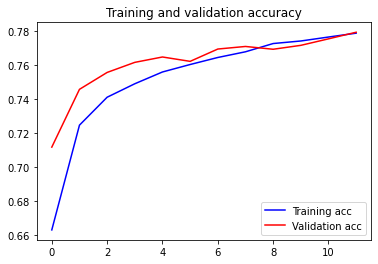

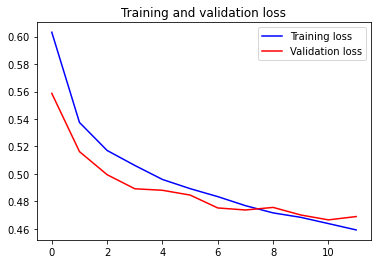

In [57]:
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from sklearn.metrics import f1_score
from sklearn.metrics import fbeta_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from matplotlib import pyplot as plt
import seaborn as sns




acc,  val_acc  = history.history['acc'], history.history['val_acc']
loss, val_loss = history.history['loss'], history.history['val_loss']
epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

* Matrice de confusion

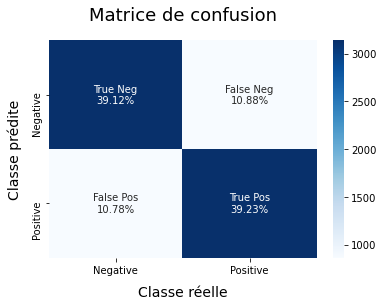

In [61]:
Y_pred = training_model.predict(X_valid)
Y_pred = np.argmax(Y_pred, axis=1)



def ConfusionMatrix(y_pred, y_test):
    cf_matrix = confusion_matrix(y_pred, y_test)

    categories  = ['Negative','Positive']
    group_names = ['True Neg','False Neg', 'False Pos','True Pos']
    group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix.flatten() / np.sum(cf_matrix)]

    labels = [f'{v1}\n{v2}' for v1, v2 in zip(group_names,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)

    sns.heatmap(cf_matrix, annot = labels, cmap = 'Blues',fmt = '',
                xticklabels = categories, yticklabels = categories)

    plt.ylabel("Classe prédite", fontdict = {'size':14}, labelpad = 10)
    plt.xlabel("Classe réelle"   , fontdict = {'size':14}, labelpad = 10)
    plt.title ("Matrice de confusion", fontdict = {'size':18}, pad = 20)

ConfusionMatrix(Y_pred, Y_valid)

* Rapport de la classification

In [62]:
print("Modèle LSTM report: \n\n",
      classification_report(Y_valid, Y_pred))

Modèle LSTM report: 

               precision    recall  f1-score   support

           0       0.78      0.78      0.78      3992
           1       0.78      0.78      0.78      4008

    accuracy                           0.78      8000
   macro avg       0.78      0.78      0.78      8000
weighted avg       0.78      0.78      0.78      8000



# 7. Optimisation des hyperparamètres du modèle LSTM bidimensionnel

* Construction d'un hypermodèle :

> On va obtenir le meilleur résultat des hyperparamètres suivants : 

* Le taux d’abandon (dropout) qui réduit le sur-apprentissage : Entre 0.1 et 0.5
* Le nombre d’unités pour la couche dense : de 32 à 512 avec un pas à 32
* Les fonctions d’activation : choix entre Relu, Sigmoid , Tanh
* le taux d’apprentissage pour l’optimizer Adam : compris entre 0.01 , 0.001 , 0.0001

In [33]:
from tensorflow import keras
from tensorflow.keras import layers
import kerastuner as kt


def model_builder(hp):
    
  model = keras.Sequential()
  model.add(layers.Embedding(input_dim=vocab_length,
                      output_dim=Embedding_dimensions,
                      weights=[embedding_matrix], 
                      input_length=X.shape[1],
                      trainable=False))

  # Tune the Dropout
  # Choose an optimal value between 0.1-0.5
  hp_dropout = hp.Float("dropout_1", min_value=0.1, max_value=0.5, default=0.25, step=0.05)

  hp_units_lstm = hp.Int('units', min_value = 10, max_value = 100, step = 10,)
  model.add(layers.Bidirectional(layers.LSTM(units=hp_units_lstm, dropout=hp_dropout, return_sequences=True)))
  model.add(layers.Bidirectional(layers.LSTM(units=hp_units_lstm, dropout=hp_dropout, return_sequences=True)))

  # Tune the number of filters for the second Conv1D 
  # Choose an optimal value from 64-128
  hp_filters = hp.Choice('num_filters', values=[64, 128], default=64,)
  model.add(layers.Conv1D(filters=hp_filters, kernel_size=3, activation='relu'))
  
  # Tune the number of units in the  Dense layer
  # Choose an optimal value between 1-16
  hp_units = hp.Int('units', min_value = 1, max_value = 16, step = 1,)

  # Tune the activation function for Dense layer
  # Choose an optimal value from relu, tanh, sigmoid
  hp_activation_dense = hp.Choice( "dense_activation", values=["relu", "tanh", "sigmoid"], default="relu" )

  model.add(layers.Dense(units=hp_units, activation=hp_activation_dense))

  model.add(layers.Dense(1,activation='sigmoid'))

 
  # Tune the learning rate for the optimizer 
  # Choose an optimal value from 0.01, 0.001, or 0.0001
  hp_learning_rate = hp.Choice('learning_rate', values = [1e-2, 1e-3, 1e-4]) 
  
  model.compile(optimizer=keras.optimizers.Adam(learning_rate = hp_learning_rate),
                loss='binary_crossentropy', 
                metrics = ['accuracy'])
  return model

* Instanciation du réglage et démarrage de l' hypertuning :

In [34]:
tuner = kt.Hyperband(model_builder,
                     objective='val_accuracy', 
                     max_epochs=10,
                     factor=3) 

INFO:tensorflow:Reloading Oracle from existing project ./untitled_project/oracle.json
INFO:tensorflow:Reloading Tuner from ./untitled_project/tuner0.json


* Apprentissage du modèle avec optimisation des hyper-paramètres :

In [35]:
from IPython.display import display
from IPython.display import clear_output


class ClearTrainingOutput(tf.keras.callbacks.Callback):
    def on_train_end(*args, **kwargs):
        clear_output(wait = True)


tuner.search(X_train, Y_train, epochs=10,
             steps_per_epoch=20, validation_data=(X_valid, Y_valid),
             verbose=1, validation_steps=3,
             callbacks=[ClearTrainingOutput()])


INFO:tensorflow:Oracle triggered exit


* Recherche des hyperparamètres et du meilleur résultat :

In [36]:
#Get the optimal hyperparameters
best_hps = tuner.get_best_hyperparameters(1)[0]

print(f"""
The hyperparameter search is complete.\n The optimal filter in first 1D Convolutional layer is  {best_hps.get('num_filters')}.\n The optimal number of units in the first densely-connected
layer is {best_hps.get('units')}.\n The optimal rate of dropout is {best_hps.get('dropout_1')} And the optimal learning rate for the optimizer is {best_hps.get('learning_rate')}.
""")


The hyperparameter search is complete.
 The optimal filter in first 1D Convolutional layer is  64.
 The optimal number of units in the first densely-connected
layer is 80.
 The optimal rate of dropout is 0.45000000000000007 And the optimal learning rate for the optimizer is 0.01.



* Sauvegarde et enegistrement du modèle tuner : 

In [ ]:
tuner.save('Sentiment_Model_Tuner')

model = Model.register(workspace=ws,
                       model_path=os.path.join('Sentiment_Model_Tuner'),
                       model_name="Sentiment_Analysi_Tuner",
                       description="Tweet Sentiment Analysis")
                       
print('Name:', model.name)
print('Version:', model.version)
